Required libraries for the project.

In [2]:
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
from scipy.spatial import distance
from scipy.ndimage.filters import convolve
from scipy.sparse import diags, csr_matrix
from scipy.sparse.linalg import spsolve
import argparse
from argparse import RawTextHelpFormatter
import glob
from os import makedirs
from os.path import join, exists, basename, splitext
import cv2
import matplotlib.pyplot as plt
import pprint
import os
import ntpath

Default values for image configuration as given in the paper. Here -


*   **size** defines the size of **Kernel** Matrix.
*   **sigma** is standard deviation in **spatial affinity**.
*   **lambda** is used to determine the smoothness of the resultant image.
*   **eps** is epsilon.



In [3]:
#default values
image_config={"be":1.0,"bs":1.0,"bc":1.0}       #1,1,1
image_config["size"]=15
image_config["sigma"]=5    #3
image_config["gamma"]=0.45   #0.6
image_config["lamda"]=0.15 #0.15
image_config["eps"]=1e-5
image_config["neighbour_dist"]=1  #1  
pprint.pprint(image_config)

{'bc': 1.0,
 'be': 1.0,
 'bs': 1.0,
 'eps': 1e-05,
 'gamma': 0.45,
 'lamda': 0.15,
 'neighbour_dist': 1,
 'sigma': 5,
 'size': 15}


*   In **init_kernel** we are calculating a 15×15 matrix known as **"Kernel"**.
*   In Kernel, we calculate the spatial affinity based Gaussian weights between each pixel pair .
*   **Spatial Affinity** is calculated using **Euclidean distance** and already defined **standard deviation (i.e. sigma)**.

In [4]:
def init_kernel_pixel(i, j,image_config):
    size = image_config["size"]
    spatial_sigma = image_config["sigma"]
    dist = distance.euclidean((i, j), (size // 2, size // 2)) ** 2
    ker_val = np.exp(-0.5 * dist / (spatial_sigma ** 2))
    return ker_val

def init_kernel(image_config):
    kernel = np.zeros((image_config["size"],image_config["size"]))
    kernel2 = np.zeros((image_config["size"],image_config["size"]))
    for i in range(image_config["size"]):
        for j in range(image_config["size"]):
            kernel[i, j] = init_kernel_pixel(i,j , image_config)
    
    return kernel

#print(init_kernel(image_config).shape)
image_config["kernel"] = init_kernel(image_config)

- Get four neighbors of each pixel and assign label based on axis. Helps deciding which smoothness weight to apply (wx or wy)

In [5]:
def get_neighbors(p, n, m):
    i, j = p // m, p % m
    nb_dist = image_config["neighbour_dist"]         
    d = {}
    if i + nb_dist < n:
        d[(i + nb_dist) * m + j] = (i + nb_dist, j, 0)
    if i - nb_dist >= 0:
        d[(i - nb_dist) * m + j] = (i - nb_dist, j, 0)
    
    if j + nb_dist < m:
        d[i * m + j + nb_dist] = (i, j + nb_dist, 1)
    if j - nb_dist >= 0:
        d[i * m + j - nb_dist] = (i, j - nb_dist, 1)
    
    return d



*   **L** is the *illumination map* which stores max intensity of 3 channels for each pixel. 
*   **L_refined** is the refined *illumination map* which preserves the prominent structure, while removing the redundant texture detail of the previous map.
*   We obtain *refined illumination map* from **improved_L_map()** function.





In [6]:
def forward_illumination(im,image_config):
    L = np.max(im, axis=2)                 #max of each channel
    L_refined = improved_L_map(L, image_config)
    L_refined_3d = np.stack((L_refined,)*3, axis=-1)
    im_corrected = np.true_divide(im ,L_refined_3d)    
    return im_corrected

#image = cv2.imread("low_light1.jpg")
#cv2_imshow(forward_illumination(image,image_config))



*   **under_corrected** stores the image where underexposed regions are enhanced **(i.e Forward Illumination)**.
*   **over_corrected** stores the image where overexposed regions are enhanced **(i.e Reverse Illumination)**.



In [7]:
def illuminate_image(image,image_config):
    kernel=init_kernel(image_config)
    image_config["kernel"]=kernel

    im_normalized = image.astype(float) / 255.
    inv_im_normalized = 1 - im_normalized

    under_corrected = forward_illumination(im_normalized, image_config)    
    over_corrected_inv =  forward_illumination(inv_im_normalized, image_config)
    over_corrected = 1 - over_corrected_inv

    return under_corrected, over_corrected




*   First we store vertical **(Lp_v)** and horizontal **(Lp_h)** features of an image using **"Sobel Filter"**
*   **colvolve()** function finds the fastest convolution/correlation method.
*   Then, we calculate **relative   total   variation   (RTV)**, for extracting meaningful and important **textural patterns** from under the complication of **texture patterns** for both horizontal and vertical features.
*   Then we decompose it further into a **piecewise smooth base layer**, containing **large scale variations** in intensity, and a **residual detail layer** capturing the smaller scale details in the image
*   This is done using **WLS ( weighted least square) Smoothing** method which combines **fine scale** and **coarse scale** technique with **Linear spatial derivatives**.


  ![Formula of WLS](https://drive.google.com/uc?export=view&id=13s_H0NQvWxuvNbDByzZOL3y87PCwY1bm)

* Subscript **p** denotes the spatial location of a pixel
*  The goal of the data term **(Lp − L'p)^2** is to minimize the distance between them (i.e. it enforces **L_refined** to be similar to the initial illumination map **L**).
* The smoothness requirement is enforced in a spatially varying manner via the smoothness weights **wx** and **wy**.
* Finally, **lamda** is responsible for the balance between the two terms; increasing the value of *lamda* results in progressively smoother images.


In [8]:
def improved_L_map(L, image_config):
    kernel = image_config["kernel"]

    Lp_h = cv2.Sobel(L, cv2.CV_64F, 1, 0, ksize=1)
    Lp_v = cv2.Sobel(L, cv2.CV_64F, 0, 1, ksize=1)

    T_h = convolve(np.ones(L.shape), kernel, mode='constant')
    T_h = T_h / (np.abs(convolve(Lp_h, kernel, mode='constant')) + image_config["eps"])

    T_v = convolve(np.ones(L.shape), kernel, mode='constant')
    T_v = T_v / (np.abs(convolve(Lp_v, kernel, mode='constant')) + image_config["eps"])

    wx=T_h / (np.abs(Lp_h) + image_config["eps"])
    wy=T_v / (np.abs(Lp_v) + image_config["eps"])

    
    L_1d = L.copy().flatten()
    row = []
    column = []
    data = []
    n, m = L.shape

    for p in range(0,n * m):
        diag = 0
        d = get_neighbors(p, n, m)
        for q in d:
            k, l, x = d[q]

            weight = wx[k, l] if x else wy[k, l]
            row.append(p)
            column.append(q)
            data.append(-weight)
            diag += weight
        row.append(p)
        column.append(p)
        data.append(diag)

    F = csr_matrix((data, (row, column)), shape=(n * m, n * m))

    Id = diags([np.ones(n * m)], [0])
    A = Id + image_config["lamda"] * F
    L_refined = spsolve(csr_matrix(A), L_1d, permc_spec=None, use_umfpack=True).reshape((n, m))

    L_refined = np.clip(L_refined, image_config["eps"], 1) ** image_config["gamma"]

    return L_refined

#image = cv2.imread("low_light1.jpg")
#L = np.max(image, axis=2)
#improved_L_map(L, image_config).shape



*   We have three images as input *(orignal image, undercorrected image, overcorrected image)*.
*   Here, we seamlessly fuse the locally best exposed parts in the two intermediateexposure correction images.
*   Due to presence of normally exposed regions in the input image, we additionally adopt the input image and perform a multi-exposure image fusion on the three images for the final exposure correction result
*   Here, we use **Merten's** method for fusion process.
>            
  *   This algorithm converts all the images to **median threshold bitmaps (MTB).**
      *  An MTB for an image is calculated by assigning the value 1 to pixels brighter than median luminance and 0 otherwise.
  *   We create a weight map using three measures of quality, they are :-
      1. **Well-exposedness** - Pixel whose intensity is similar to middle intensity (i.e. 128) are preffered. 
      2. **Contrast**  - Higher contrast value are given higher weightage.
      3. **Saturation** - If saturation of a particular pixel is high then they are given a higher weight for that pixel.
    * A *weight map* **W(i,j,k)** represents the contribution of the *k* image in the final intensity of the pixel at location **(i,j)**.
    * Weight map is normalized such that for any pixel **(i, j)**, the contribution of all images add up to 1.
    * The resulting image is obtained by a weighted blending of the input images. But, wherever weights vary quickly, disturbing seams will appear. This seam problem can be rsolved using  a technique in-spired by **Burt and Adelson**.
    * **Burt and Adelson :** It uses **"Laplacian Pyramids""** method for blending the images.





In [9]:
#assuming img2 and img3 are normalized by 255
#return value is multiplied by 255 beforehand
def merge(img1, img2, img3):
  merge_mertens = cv2.createMergeMertens(image_config["bc"], image_config["bs"], image_config["be"])
  img2=img2*255
  img3=img3*255
  images = [np.clip(x , 0, 255).astype("uint8") for x in [img1, img2, img3]]
  fused_images = merge_mertens.process(images)
  return fused_images*255



Observations we made after experimenting with varying values of **Exposure, Contrast and Saturation.**

**Exposure**

Exposure value is = 
Normal Image      0       0.5       1       

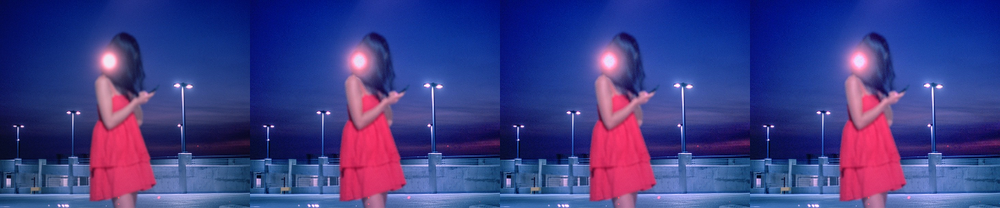

Exposure value is = 
Normal Image      0       0.5       1       

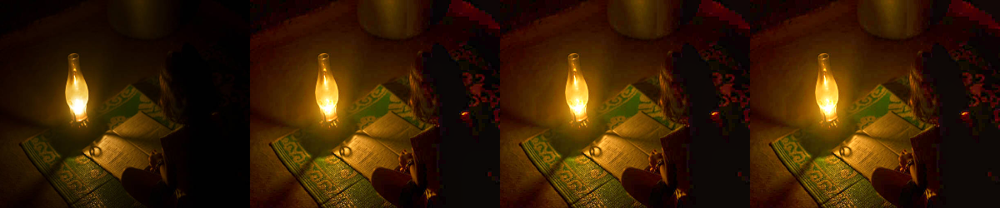

Exposure value is = 
Normal Image      0       0.5       1       

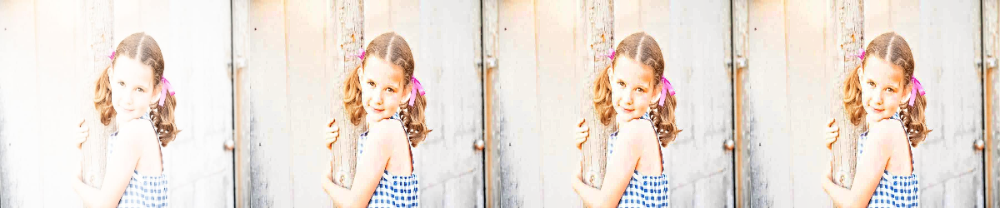

Exposure value is = 
Normal Image      0       0.5       1       

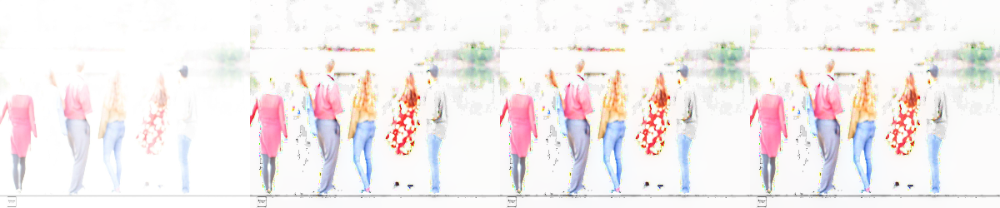

In [ ]:
from PIL import Image
imgpath=[]
exposure_val=[0,0.5,1]
imgs=["underexp1.jpeg","underexp2.jpeg","overexp1.jpeg","overexp2.jpeg"]
for path in imgs:
  image = cv2.resize(cv2.imread(path),(300,250))
  corr1 , corr2 = illuminate_image(image,image_config)
  print("Exposure value is = ")
  print("Normal Image ",end="     ")
  for i in range(0,len(exposure_val)):
    print(exposure_val[i],end="       ")
    image_config["be"]=exposure_val[i]
    fused_images = merge(image, corr1, corr2)
    if i==0:
        image2 = np.hstack((image,fused_images))
    else:
        image2 = np.hstack((image2,fused_images))

  cv2_imshow(image2)


**Contrast**

Contrast value is = 
Normal Image      0       0.5       1       

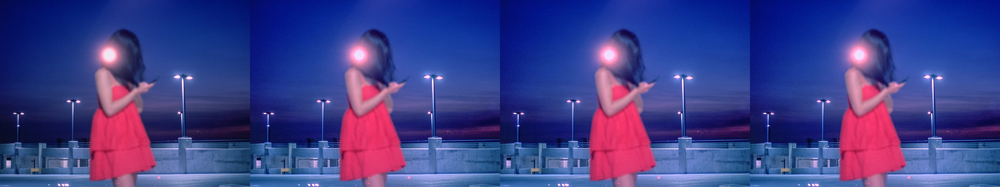

Contrast value is = 
Normal Image      0       0.5       1       

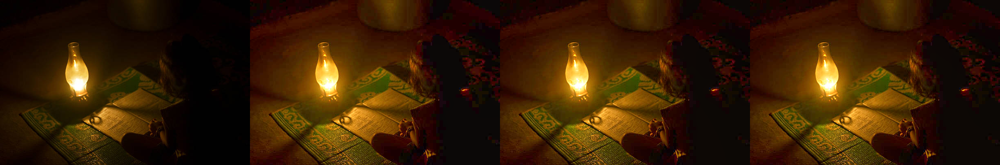

Contrast value is = 
Normal Image      0       0.5       1       

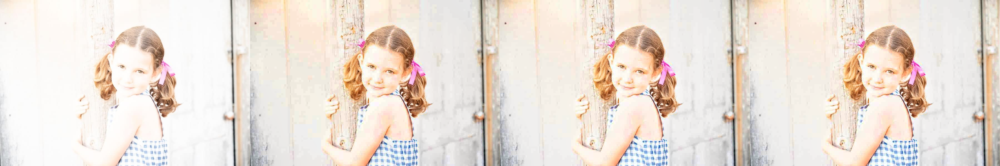

Contrast value is = 
Normal Image      0       0.5       1       

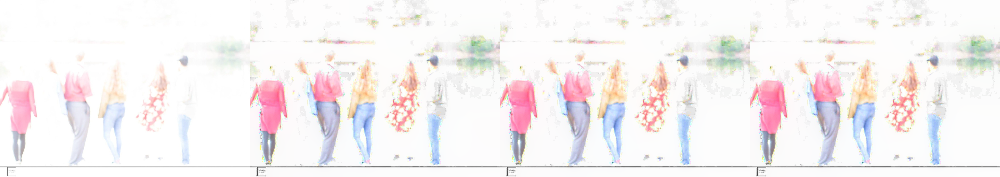

In [ ]:
from PIL import Image
contrast_val=[0,0.5,1]
imgs=["/content/test images/underexp1.jpeg","/content/test images/underexp2.jpeg","/content/test images/overexp1.jpeg","/content/test images/overexp2.jpeg"]
for path in imgs:
  image = cv2.imread(path)
  corr1 , corr2 = illuminate_image(image,image_config)
  print("Contrast value is = ")
  print("Normal Image ",end="     ")
  for i in range(0,len(contrast_val)):
    print(contrast_val[i],end="       ")
    image_config["bc"]=contrast_val[i]
    fused_images = merge(image, corr1, corr2)
    if i==0:
        image2 = np.hstack((image,fused_images))
    else:
        image2 = np.hstack((image2,fused_images))

  cv2_imshow(image2)


**Saturation**

Saturation value is = 
Normal Image      0       0.5       1       

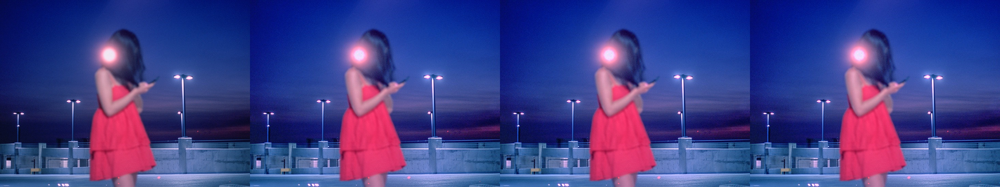

Saturation value is = 
Normal Image      0       0.5       1       

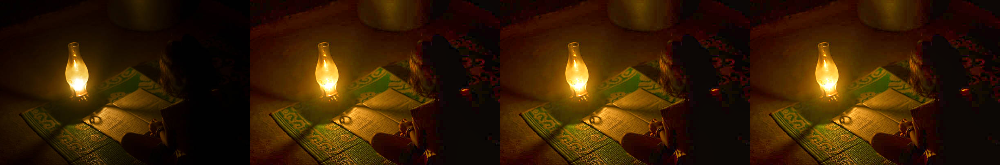

Saturation value is = 
Normal Image      0       0.5       1       

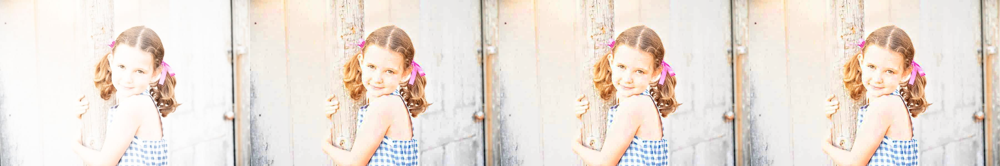

Saturation value is = 
Normal Image      0       0.5       1       

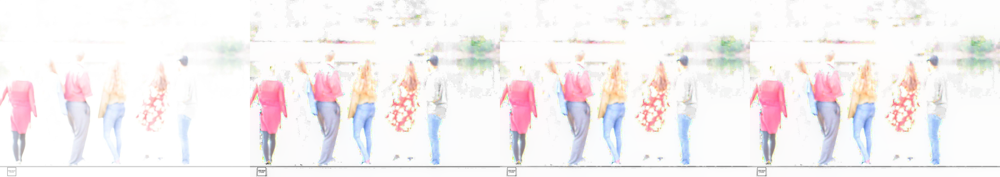

In [ ]:
from PIL import Image
imgpath=[]
sat_val=[0,0.5,1]
imgs=["/content/test images/underexp1.jpeg","/content/test images/underexp2.jpeg","/content/test images/overexp1.jpeg","/content/test images/overexp2.jpeg"]
for path in imgs:
  image = cv2.imread(path)
  corr1 , corr2 = illuminate_image(image,image_config)
  print("Saturation value is = ")
  print("Normal Image ",end="     ")
  for i in range(0,len(sat_val)):
    print(sat_val[i],end="       ")
    image_config["bs"]=sat_val[i]
    fused_images = merge(image, corr1, corr2)
    if i==0:
        image2 = np.hstack((image,fused_images))
    else:
        image2 = np.hstack((image2,fused_images))

  cv2_imshow(image2)


- Enhance image and return all four images as list. 
- Format of returned list : [original_image , underexpose_corrected_image, overexpose_corrected_image , fused_image]
- Second argument is the output directory to store fused image in.

In [ ]:
def correct_and_store_image(imgpath , output_dir = "outputs"):
    image = cv2.imread(imgpath)

    # create new directory for saving result
    if not exists(output_dir):
        makedirs(output_dir)

    enhanced_image1, enhanced_image2 = illuminate_image(image,image_config)
    fused_image = merge(image, enhanced_image1, enhanced_image2)

    name = ntpath.basename(imgpath)     #Extract file name from path, no matter what the os/path format
    name,ext = name.split(".")
    op_name = name + "_corrected." + ext
    
    cv2.imwrite(join(output_dir , op_name), fused_image)

    #return all 4 images as list
    return [image , enhanced_image1, enhanced_image2 , fused_image]

In [ ]:
im_list = correct_and_store_image("underexp2.jpeg" , output_dir="mydir" )

From left:- 1)original image 2) underexpose corrected image 3) overexpose corrected image 4) fused image



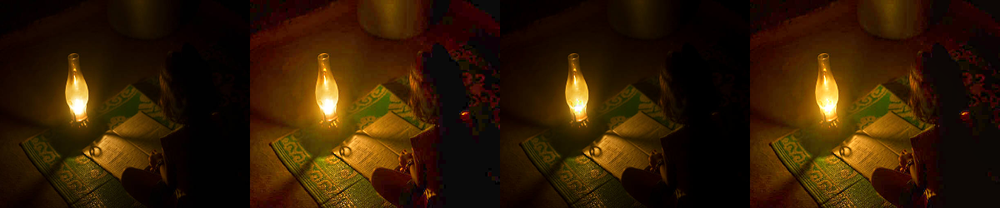

In [ ]:
im_list = [cv2.resize(img , (300,250)) for img in im_list]
all_img = np.concatenate((im_list[0] , im_list[1]*255 , im_list[2]*255 , im_list[3]), axis=1)
print("From left:- 1)original image 2) underexpose corrected image 3) overexpose corrected image 4) fused image\n")
cv2_imshow(all_img)

### Template code for any image

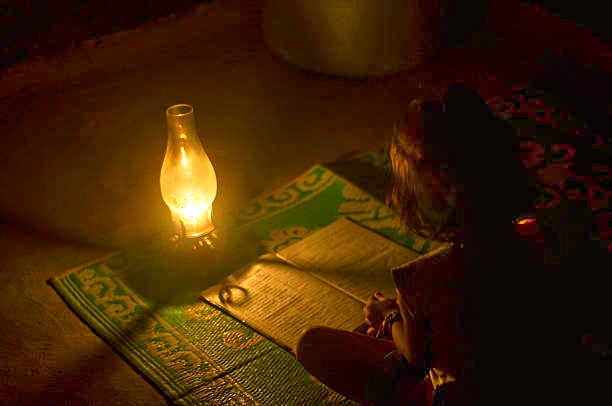

In [ ]:
imgpath = "underexp2.jpeg"
image = cv2.imread(imgpath)
corr1 , corr2 = illuminate_image(image,image_config)
fused_images = merge(image, corr1, corr2)
cv2_imshow(fused_images)

## Results

### **1) For UnderExposed Images**


Original images



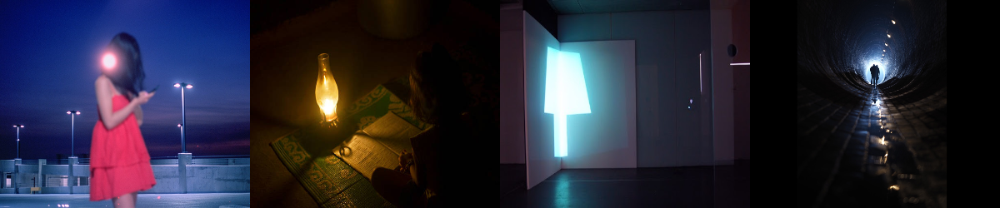


Corrected images



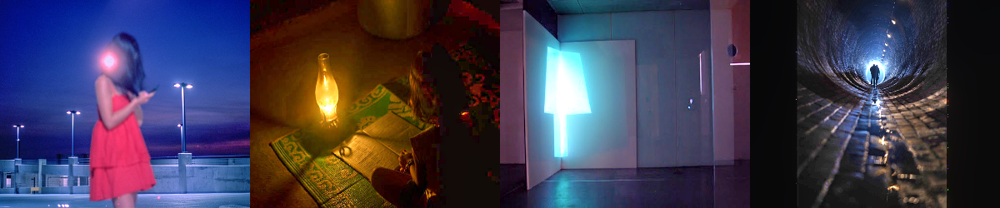

In [ ]:
imgpaths = ["underexp1.jpeg","underexp2.jpeg","underexp3.jpeg","underexp4.jpg"]
image_config["gamma"]=0.5
for i in range(0,len(imgpaths)):
    imgpath = imgpaths[i]
    image = cv2.resize(cv2.imread(imgpath),(300,250))
    corr1 , corr2 = illuminate_image(image,image_config)
    fused_images = merge(image, corr1, corr2)

    if i==0:
        original = image
        corrected = fused_images
    else:
        original = np.hstack((original,image))
        corrected = np.hstack((corrected,fused_images))

print("\nOriginal images\n")
cv2_imshow(original)
print("\nCorrected images\n")
cv2_imshow(corrected)

### **2) For OverExposed Images**


Original images



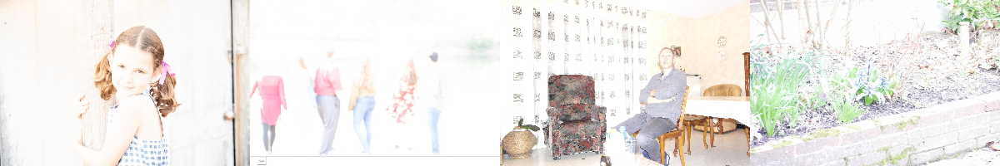


Corrected images



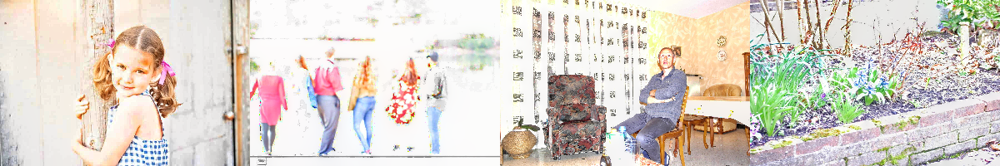

In [ ]:
imgpaths = ["overexp1.jpeg" , "overexp2.jpeg" , "overexp3.jpeg" , "ovr2.jpg"]
for i in range(0,len(imgpaths)):
    imgpath = imgpaths[i]
    image = cv2.resize(cv2.imread(imgpath),(300,200))
    corr1 , corr2 = illuminate_image(image,image_config)
    fused_images = merge(image, corr1, corr2)

    if i==0:
        original = image
        corrected = fused_images
    else:
        original = np.hstack((original,image))
        corrected = np.hstack((corrected,fused_images))

print("\nOriginal images\n")
cv2_imshow(original)
print("\nCorrected images\n")
cv2_imshow(corrected)

## **Changing values of Gamma**

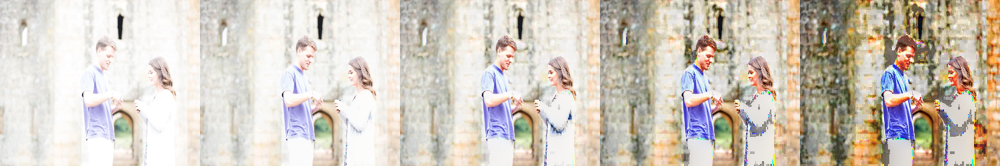

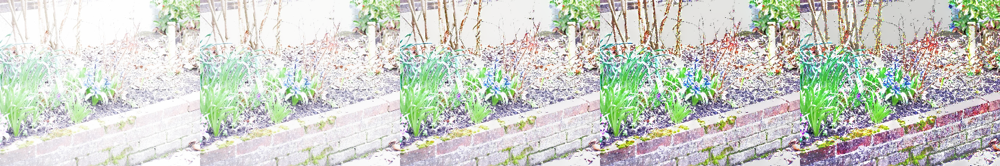

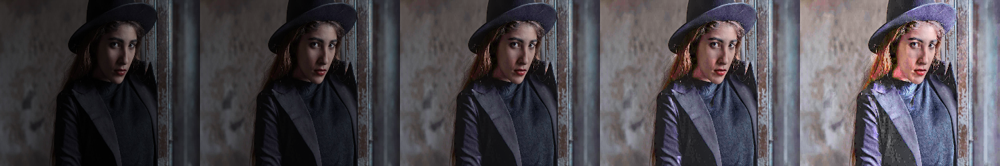

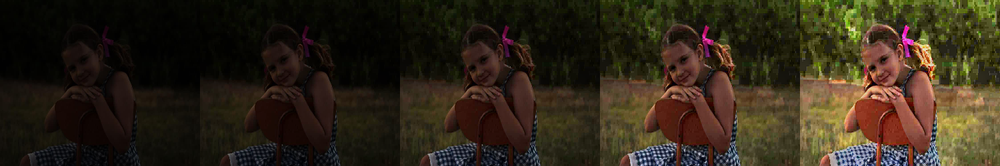

In [ ]:
from PIL import Image
import numpy
from PIL import Image
import numpy
gm_val=[0.2,0.4,0.6,0.8]
imgs=["ovr1.jpg","ovr2.jpg","und1.jpg","und2.jpg"]
for j in range(0,len(imgs)):
    for i in range(0,len(gm_val)):
        imgpath = imgs[j]
        image_config["gamma"]=gm_val[i]
        image = cv2.resize(cv2.imread(imgpath),(300,250))
        corr1 , corr2 = illuminate_image(image,image_config)
        fused_images = merge(image,corr1, corr2)
        if i==0:
            image2 = numpy.hstack((image,fused_images))
        else:
            image2 = numpy.hstack((image2,fused_images))
    cv2_imshow(image2)




### **First image is the original image which is taken as input. Other images are the output on various values of gamma like 0.2, 0.4, 0.6, 0.8**

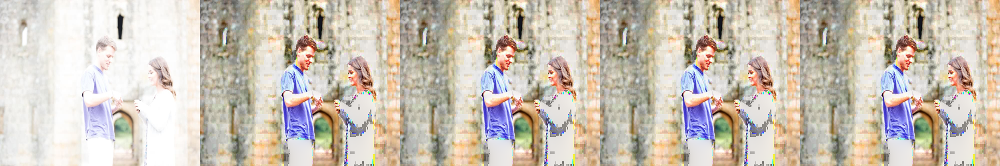

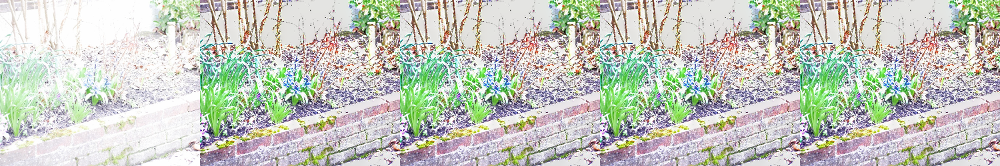

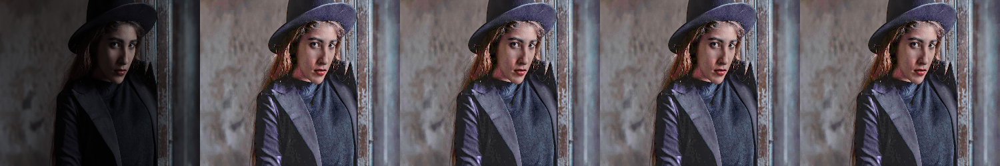

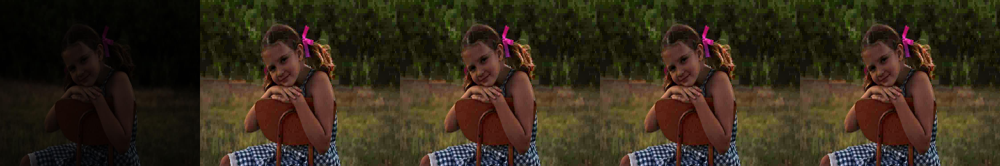

In [ ]:
image_config["gamma"]=0.6
gm_val=[0.01,0.1,0.45,0.8]
imgs=["ovr1.jpg","ovr2.jpg","und1.jpg","und2.jpg"]
for j in range(0,len(imgs)):
    for i in range(0,len(gm_val)):
        imgpath = imgs[j]
        image_config["lambda"]=gm_val[i]
        image = cv2.resize(cv2.imread(imgpath),(300,250))
        corr1 , corr2 = illuminate_image(image,image_config)
        fused_images = merge(image,corr1 , corr2)
        if i==0:
            image2 = numpy.hstack((image,fused_images))
        else:
            image2 = numpy.hstack((image2,fused_images))

    cv2_imshow(image2)


### **First image is the original image which is taken as input. Other images are the output on various values of lambda like 0.01, 0.1, 0.45, 0.8**

# Contrast enhancement using histogram Equalization (Scratch)

- Apply the equalization method for one channel image. Here we call this method iteratively for each channel. 

In [23]:
#for 1 channel
def equalize_histogram(image):
    image_hist = np.zeros(256)
    image_flat = image.flatten()
    
    for pix in image:
        image_hist[pix] += 1

    cum_sum = np.cumsum(image_hist)
    cum_min = cum_sum.min()
    cum_max = cum_sum.max()

    uniform_norm = ((cum_sum - cum_min) * 255) / (cum_max - cum_min)
    
    uniform_norm = uniform_norm.astype('int')

    image_eq = uniform_norm[image_flat]
    image_eq = np.reshape(image_eq, image.shape)

    return image_eq

- Split image to 3 channels, apply contrast enhancement and then merge all channels.

In [24]:
def contrast_enhance(image_src, gray_scale=False):
    if not gray_scale:
        ch_list = []
        for i in range(3):
            ch_image = image_src[:, :, i]
            ch_image_eq = equalize_histogram(ch_image)
            ch_list.append(ch_image_eq)

        image_eq = np.dstack(ch_list)
        
    return np.uint8(image_eq)

- Images turn out to be sharper with enhancement.

Left:- Original 	 Right:- Enhanced



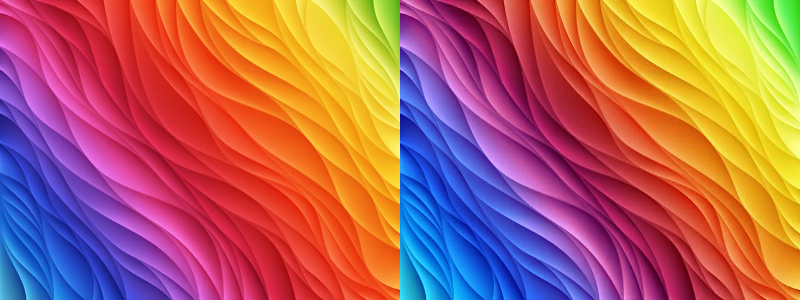

In [25]:
imgpath = "normal2.jpeg"
image = cv2.resize(cv2.imread(imgpath),(400,300))
enh_img = contrast_enhance(image)

comp = np.concatenate((image , enh_img), axis=1)
print("Left:- Original \t Right:- Enhanced\n")
cv2_imshow(comp)

#### Visualization of Histogram equalization in each channel

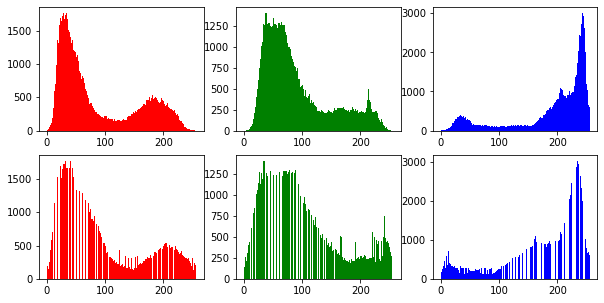

In [26]:
color_list = ["red" , "green" , "blue"]

plt.figure(figsize =(10, 5))
for i in range(3):
    plt.subplot(2,3,i+1)
    plt.hist(image[:,:,i].flatten(),256,[0,256], color = color_list[i])
    plt.subplot(2,3,i+1+3)
    plt.hist(enh_img[:,:,i].flatten(),256,[0,256], color = color_list[i])
plt.show()

- Variation in smoothness weights w.r.t contrast enhancement. These weights determine how to illuminae image and we can see how there is more prominent distinctions in the image features here.

In [27]:
def find_w(image , orientation="h"):
    L = np.max(image, axis=-1)
    if orientation=="h":
        Lp = cv2.Sobel(L, cv2.CV_64F, 1, 0, ksize=1)
    if orientation=="v":
        Lp = cv2.Sobel(L, cv2.CV_64F, 0, 1, ksize=1)

    T = convolve(np.ones_like(L), image_config["kernel"], mode='constant')
    T = T / (np.abs(convolve(Lp, image_config["kernel"], mode='constant')) + image_config["eps"])
    w = T / (np.abs(Lp) + image_config["eps"])
    return w

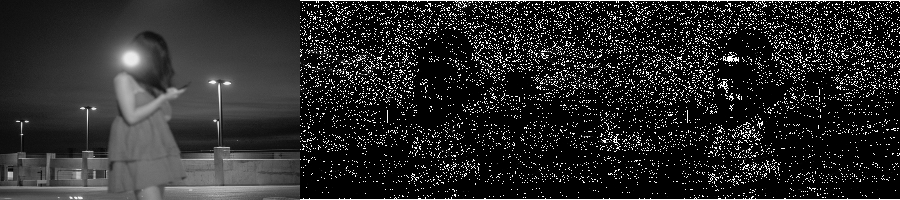

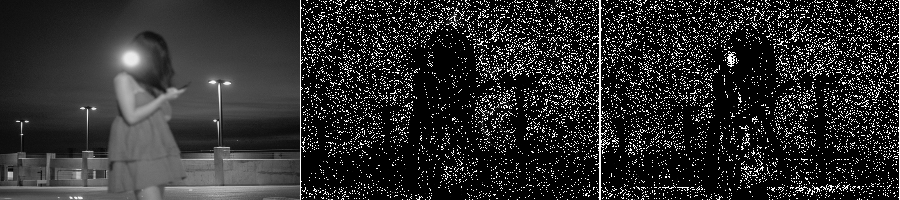

In [28]:
imgpath = "underexp1.jpeg"
image = cv2.resize(cv2.imread(imgpath) , (300,200))
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

enh_img = contrast_enhance(image)

ver = np.concatenate((gray_image,find_w(image,"v"), find_w(enh_img,"v")), axis=1)
cv2_imshow(ver)

hor = np.concatenate((gray_image,find_w(image,"h"), find_w(enh_img,"h")), axis=1)
cv2_imshow(hor)

#### Using contrast enhancement for different scenarios

- Using enhanced image during fusion phase.

From left: a) Original	 b) Using original image for fusion	 c) Using enhanced image for fusion
 


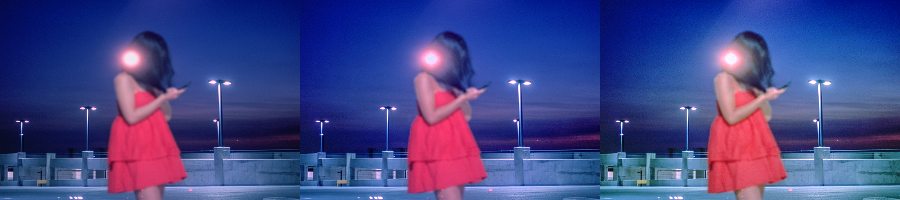

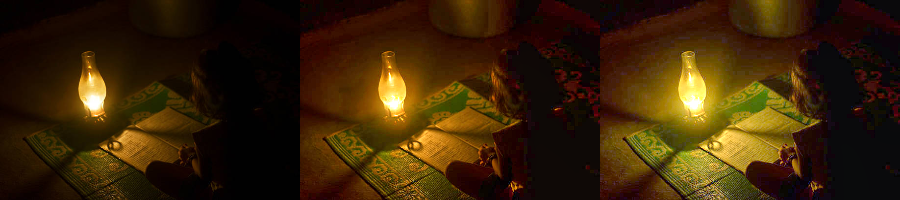

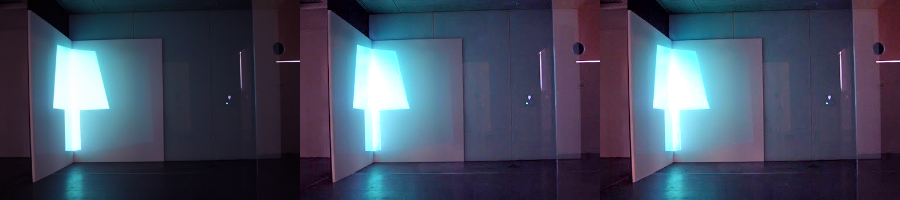

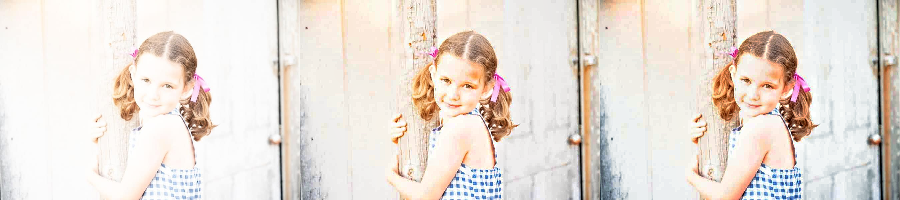

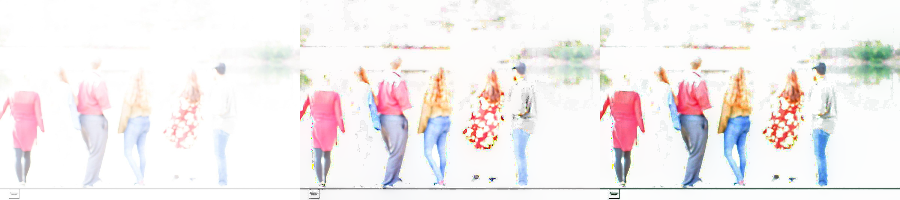

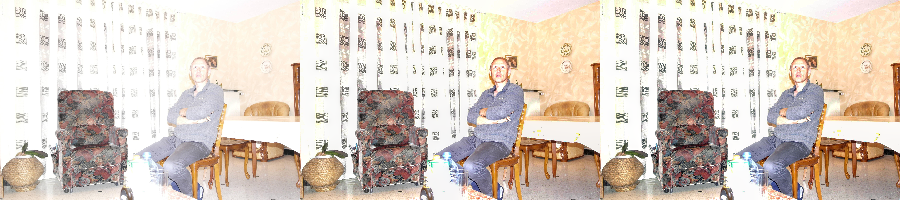

In [30]:
imgpaths = ["underexp1.jpeg","underexp2.jpeg","underexp3.jpeg" , "overexp1.jpeg" , "overexp2.jpeg","overexp3.jpeg" ]
print("From left: a) Original\t b) Using original image for fusion\t c) Using enhanced image for fusion\n ")

for imgpath in imgpaths:
    image = cv2.resize(cv2.imread(imgpath),(300,200))
    enh_img = contrast_enhance(image)

    corr1 , corr2 = illuminate_image(image,image_config)
    fused_images1 = merge(image, corr1, corr2)
    fused_images2 = merge(enh_img, corr1, corr2)          
    

    Hori = np.concatenate((image, fused_images1), axis=1)
    Hori = np.concatenate((Hori, fused_images2), axis=1)

    cv2_imshow(Hori)

- Using enhanced image during dual illumination phase

From left: a) Original	 b) Using original image for fusion	 c) Using enhanced image dual illumination phase
 


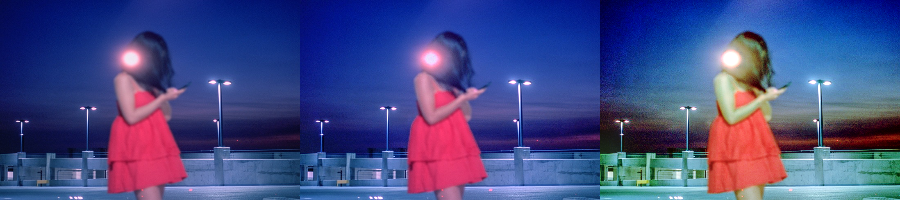

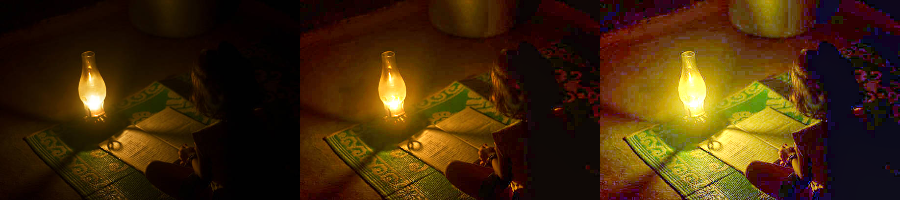

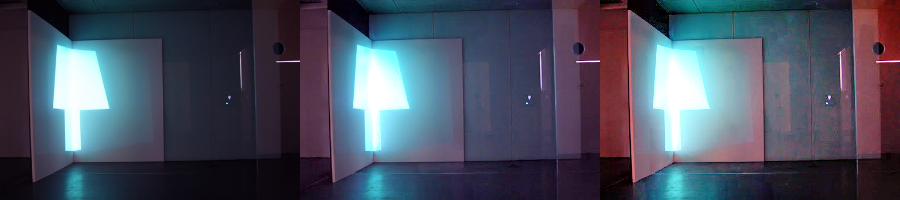

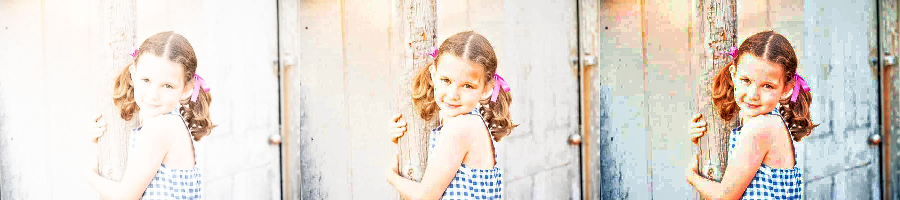

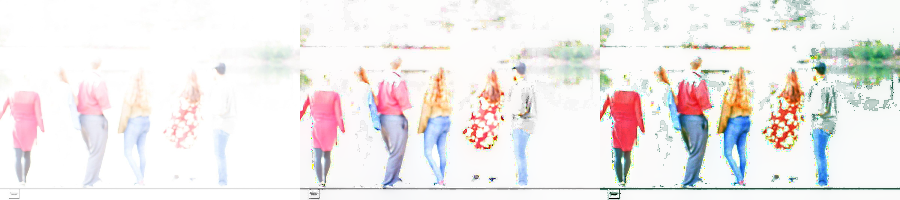

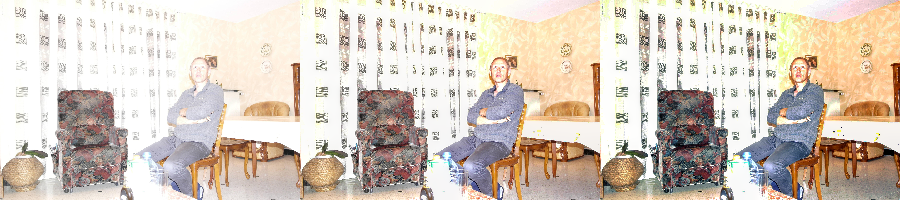

In [31]:
imgpaths = ["underexp1.jpeg","underexp2.jpeg","underexp3.jpeg" , "overexp1.jpeg" , "overexp2.jpeg" ,"overexp3.jpeg" ]
print("From left: a) Original\t b) Using original image for fusion\t c) Using enhanced image dual illumination phase\n ")

for imgpath in imgpaths:
    image = cv2.resize(cv2.imread(imgpath),(300,200))
    enh_img = contrast_enhance(image)

    corr1 , corr2 = illuminate_image(image,image_config)
    fused_images1 = merge(image, corr1, corr2)

    corr1 , corr2 = illuminate_image(enh_img,image_config)
    fused_images2 = merge(image, corr1, corr2)          
    

    Hori = np.concatenate((image, fused_images1), axis=1)
    Hori = np.concatenate((Hori, fused_images2), axis=1)

    cv2_imshow(Hori)

- Using enhanced image during both, dual illumination and merge phase

From left: a) Original	 b) Using original image for fusion	 c) Using enhanced image for dual illumination and merge phase
 


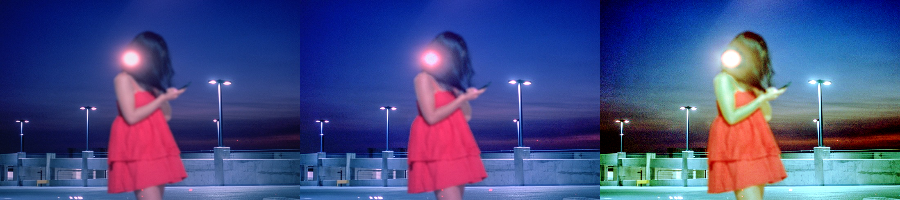

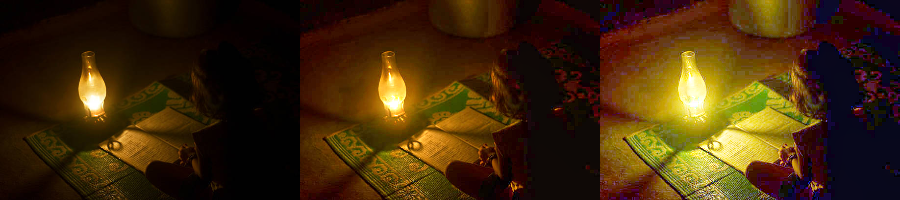

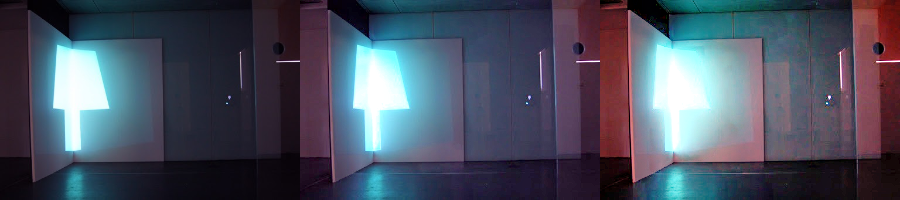

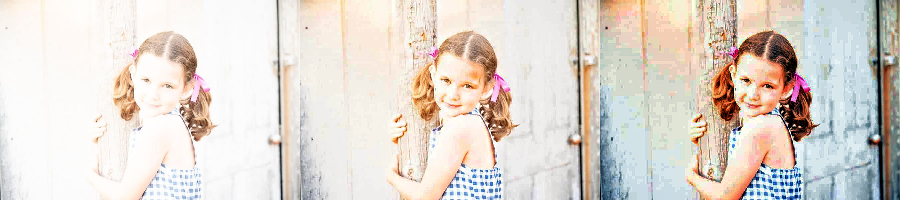

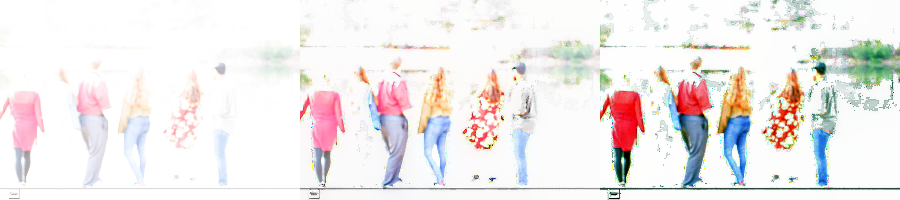

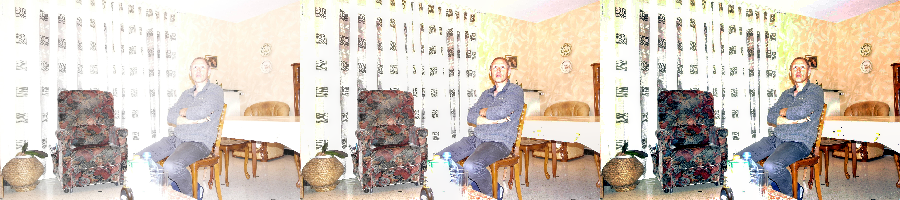

In [32]:
imgpaths = ["underexp1.jpeg","underexp2.jpeg","underexp3.jpeg" , "overexp1.jpeg" , "overexp2.jpeg" ,"overexp3.jpeg"]
print("From left: a) Original\t b) Using original image for fusion\t c) Using enhanced image for dual illumination and merge phase\n ")

for imgpath in imgpaths:
    image = cv2.resize(cv2.imread(imgpath),(300,200))
    enh_img = contrast_enhance(image)

    corr1 , corr2 = illuminate_image(image,image_config)
    fused_images1 = merge(image, corr1, corr2)

    corr1 , corr2 = illuminate_image(enh_img,image_config)
    fused_images2 = merge(enh_img, corr1, corr2)          
    
    Hori = np.concatenate((image, fused_images1), axis=1)
    Hori = np.concatenate((Hori, fused_images2), axis=1)

    cv2_imshow(Hori)

# **DIM LIGHT VIDEO CONVERSION**

*   We capture a video, using a VideoCapture object.
*   We can provide video in two ways :-


>    
  1.   By giving the path and name of a video file. 
  2.   By giving the device index (i.e. giving kive video via camera).

*   The video is stored in **video** variable.





In [ ]:
import numpy as np
import cv2 as cv
video = []
corrected_video = []

cap = cv.VideoCapture("vid1.mp4")
if (not cap.isOpened()): 
    print("Cannot open camera")
    exit()
i = 0
while True:
    ret, frame = cap.read()
    if not ret:
        break
    i+=1
    video.append(frame)
video = np.array(video)
print(video.shape)


(258, 352, 640, 3)


*  Here we are passing each frame of a video as an image to **illuminate_image()** function.
*  The function returns two enhanced images that are passed in the **merge()** function.
*   The function returns enhanced image and which is stored in **out_frame**.
*   **out_frame** is the frame of enhanced video stored in **corrected_video**


In [ ]:
corrected_video = []
count=0
for idx, frame in enumerate(video):
    print(idx, frame.shape)
    enhanced_image1, enhanced_image2 = illuminate_image(frame,image_config)
    out_frame = merge(frame, enhanced_image1, enhanced_image2)
    cv2.imwrite("./temp_converted/"+str(count)+".jpg",out_frame)
    count+=1

0 (352, 640, 3)
1 (352, 640, 3)
2 (352, 640, 3)
3 (352, 640, 3)
4 (352, 640, 3)
5 (352, 640, 3)
6 (352, 640, 3)
7 (352, 640, 3)
8 (352, 640, 3)
9 (352, 640, 3)
10 (352, 640, 3)
11 (352, 640, 3)
12 (352, 640, 3)
13 (352, 640, 3)
14 (352, 640, 3)
15 (352, 640, 3)
16 (352, 640, 3)
17 (352, 640, 3)
18 (352, 640, 3)
19 (352, 640, 3)
20 (352, 640, 3)
21 (352, 640, 3)
22 (352, 640, 3)
23 (352, 640, 3)
24 (352, 640, 3)
25 (352, 640, 3)
26 (352, 640, 3)
27 (352, 640, 3)
28 (352, 640, 3)
29 (352, 640, 3)
30 (352, 640, 3)
31 (352, 640, 3)
32 (352, 640, 3)
33 (352, 640, 3)
34 (352, 640, 3)
35 (352, 640, 3)
36 (352, 640, 3)
37 (352, 640, 3)
38 (352, 640, 3)
39 (352, 640, 3)
40 (352, 640, 3)
41 (352, 640, 3)
42 (352, 640, 3)
43 (352, 640, 3)
44 (352, 640, 3)
45 (352, 640, 3)
46 (352, 640, 3)
47 (352, 640, 3)
48 (352, 640, 3)
49 (352, 640, 3)
50 (352, 640, 3)
51 (352, 640, 3)
52 (352, 640, 3)
53 (352, 640, 3)
54 (352, 640, 3)
55 (352, 640, 3)
56 (352, 640, 3)
57 (352, 640, 3)
58 (352, 640, 3)
59 (352

In [ ]:
def generate_video():
    image_folder = './temp_converted/' # make sure to use your folder
    video_name = 'video_created.avi'
    #os.chdir("/content/drive/My Drive/COMPUTER VISION/project/video_imgs/")
      
    images = [img for img in os.listdir(image_folder)
              if img.endswith(".jpg") or
                 img.endswith(".jpeg") or
                 img.endswith("png")]
    img2=[]
    leng=len(images)
    for i in range(0,leng):
        img2.append(str(i)+".jpg")
        
    # Array images should only consider
    # the image files ignoring others if any
    
    frame = cv2.imread(os.path.join(image_folder, img2[0]))
  
    # setting the frame width, height width
    # the width, height of first image
    height, width, layers = frame.shape  
    fourcc = cv.VideoWriter_fourcc(*'XVID')
  
    video = cv2.VideoWriter(video_name, fourcc, 30, (width, height)) 
  
    # Appending the images to the video one by one
    for image in img2: 
        video.write(cv2.imread(os.path.join(image_folder, image))) 
    
generate_video()
